<a href="https://colab.research.google.com/github/tanakakao/studymemo/blob/main/gcgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Dense, Conv2D, Conv2DTranspose, UpSampling2D, Activation, MaxPooling2D, Flatten, LeakyReLU, Dropout, GlobalAveragePooling2D, BatchNormalization, Reshape, ReLU
from tensorflow.keras import regularizers
from tensorflow.keras import initializers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau
from keras.datasets import mnist
import tensorflow as tf

import numpy as np
import cv2

import matplotlib.pyplot as plt

In [ ]:
class gen_conv(Model):
    def __init__(self, out_channels, kernel_size=3, stride=2, padding='same', bn=True, bias = False, final=False):
        super().__init__()
        if final:
          self.conv = Conv2D(out_channels,
                             kernel_size=kernel_size,
                             strides=stride,
                             padding=padding,
                             use_bias=bias)
          self.bn = None
          self.act = Activation("tanh")
        else:
          self.conv = Conv2DTranspose(out_channels,
                                    kernel_size=kernel_size,
                                    strides=stride,
                                    padding=padding,
                                    use_bias=bias)
          self.bn = BatchNormalization(momentum=0.8)
          self.act = ReLU()

    def call(self, x):
        x = self.conv(x)
        if self.bn:
            x = self.bn(x)
        x = self.act(x)

        return x

class Generator(Model):
    def __init__(self):
        super().__init__()
        self.linear = Dense(128*7*7, activation="relu")

        self.gen1 = gen_conv(out_channels=128, kernel_size=3, stride=2, padding='same')
        self.gen2 = gen_conv(out_channels=64, kernel_size=3, stride=2, padding='same')
        self.gen3 = gen_conv(out_channels=1, kernel_size=3, stride=1, padding='same', final=True)

    def call(self, x):
        x = self.linear(x)
        x = Reshape(target_shape=(7,7,128))(x)
        x = self.gen1(x)
        x = self.gen2(x)
        x = self.gen3(x)
        return x

In [ ]:
gen = Generator()
gen.build((None,100))  # build with input shape.
dummy_input = Input(shape=(100))  # declare without batch demension.
model_summary = Model(inputs=[dummy_input], outputs=gen.call(dummy_input))
model_summary.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 dense (Dense)               (None, 6272)              633472    
                                                                 
 reshape (Reshape)           (None, 7, 7, 128)         0         
                                                                 
 gen_conv (gen_conv)         (None, 14, 14, 128)       147968    
                                                                 
 gen_conv_1 (gen_conv)       (None, 28, 28, 64)        73984     
                                                                 
 gen_conv_2 (gen_conv)       (None, 28, 28, 1)         576       
                                                                 
Total params: 856,000
Trainable params: 855,616
Non-trainable

In [ ]:
class disc_conv(Model):
    def __init__(self, out_channels, kernel_size=5, stride=2, padding='same', bn=True, bias=False, final=False):
        super().__init__()
        self.act = LeakyReLU(alpha=0.2)
        self.drop = Dropout(0.25)
        self.conv = Conv2D(out_channels,
                           kernel_size=kernel_size,
                           strides=stride,
                           padding=padding,
                           use_bias=bias)

    def call(self, x):
        x = self.conv(x)
        x = self.drop(x)
        x = self.act(x)

        return x

class Discriminator(Model):
    def __init__(self):
        super().__init__()
        self.disc1 = disc_conv(out_channels=32, kernel_size=3, stride=2, padding='same')
        self.disc2 = disc_conv(out_channels=64, kernel_size=3, stride=2, padding='same')
        self.disc3 = disc_conv(out_channels=128, kernel_size=3, stride=2, padding='same')
        self.disc4 = disc_conv(out_channels=256, kernel_size=3, stride=1, padding='same')

        self.flat = Flatten()
        self.out = Dense(1, activation='sigmoid')

    def call(self, x):
        x = self.disc1(x)
        x = self.disc2(x)
        x = self.disc3(x)
        x = self.disc4(x)

        x = self.flat(x)
        x = self.out(x)

        return x

In [ ]:
disc = Discriminator()
disc.build((None,28,28,1))  # build with input shape.
dummy_input = Input(shape=(28,28,1))  # declare without batch demension.
model_summary = Model(inputs=[dummy_input], outputs=disc.call(dummy_input))
model_summary.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 disc_conv (disc_conv)       (None, 14, 14, 32)        288       
                                                                 
 disc_conv_1 (disc_conv)     (None, 7, 7, 64)          18432     
                                                                 
 disc_conv_2 (disc_conv)     (None, 4, 4, 128)         73728     
                                                                 
 disc_conv_3 (disc_conv)     (None, 4, 4, 256)         294912    
                                                                 
 flatten (Flatten)           (None, 4096)              0         
                                                                 
 dense_1 (Dense)             (None, 1)                 4097

In [ ]:
class GAN(Model):
    def __init__(self, Discriminator, Generator):
        super().__init__()
        self.gen = Generator
        self.disc = Discriminator

    def call(self, x):
        x = self.gen(x)
        x = self.disc(x)

        return x

In [ ]:
gan = GAN(disc, gen)
gan.build((None,100))  # build with input shape.
dummy_input = Input(shape=(100))  # declare without batch demension.
model_summary = Model(inputs=[dummy_input], outputs=gan.call(dummy_input))
model_summary.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 100)]             0         
                                                                 
 generator (Generator)       (None, 28, 28, 1)         856000    
                                                                 
 discriminator (Discriminato  (None, 1)                391457    
 r)                                                              
                                                                 
Total params: 1,247,457
Trainable params: 1,247,073
Non-trainable params: 384
_________________________________________________________________


In [ ]:
(x_train, y_train), (x_test, y_test) = mnist.load_data()

x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)
x_test = x_test.reshape(x_test.shape[0], 28, 28, 1)
x_train=x_train.astype('float32')
x_test.astype('float32')
x_train = x_train/127.5 - 1
x_test = x_test/127.5 - 1

-1.0

In [ ]:
def generate_images(i, type='keras'):
    n_rows  =16
    n_cols = 16
    if type=='numpy':
        noise = np.random.normal(0, 1, (n_rows*n_cols, n_noise))
        g_imgs = forward_propagation(noise, gen_layers)
    elif type=='keras':
        noise = np.random.normal(0, 1, (n_rows*n_cols, n_noise))
        g_imgs = np.array(gan.gen(noise))
    else:
        #noise = torch.randn(n_rows*n_cols, n_noise)
        noise = torch.normal(0,1,(n_rows*n_cols, n_noise))
        g_imgs = generator(noise)
        g_imgs = g_imgs.detach().numpy()

    g_imgs = g_imgs/2 + 0.5

    img_size_spaced = img_size + 2

    matrix_image = np.zeros((img_size_spaced*n_rows,
                             img_size_spaced*n_cols))

    for r in range(n_rows):
        for c in range(n_cols):
            g_img = g_imgs[r*n_cols + c].reshape(img_size, img_size)
            top = r*img_size_spaced
            left = c*img_size_spaced
            matrix_image[top:top+img_size, left:left+img_size] = g_img

    plt.figure(figsize=(8,8))
    plt.imshow(matrix_image.tolist(), cmap='Greys_r')
    plt.tick_params(labelbottom=False, labelleft=False, bottom=False, left=False)
    plt.show()

In [ ]:
from tensorflow.keras.optimizers import Adam

n_noise = 100

optim = Adam(lr=2e-5, beta_1=0.2)

discriminator = Discriminator()
discriminator.compile(loss='binary_crossentropy', optimizer=optim, metrics=['accuracy'])
# discriminatorのcompile後にFalseとする(compileしたものには影響がない)
discriminator.trainable = False

optim = Adam(lr=2e-5, beta_1=0.2)
generator = Generator()
gan = GAN(discriminator, generator)
gan.compile(loss='binary_crossentropy', optimizer=optim, metrics=['accuracy'])

n_learn: 0
Error_fake: 0.7067635953426361 Acc_fake: 0.0703125
Error_real: 0.6141020059585571 Acc_real: 1.0


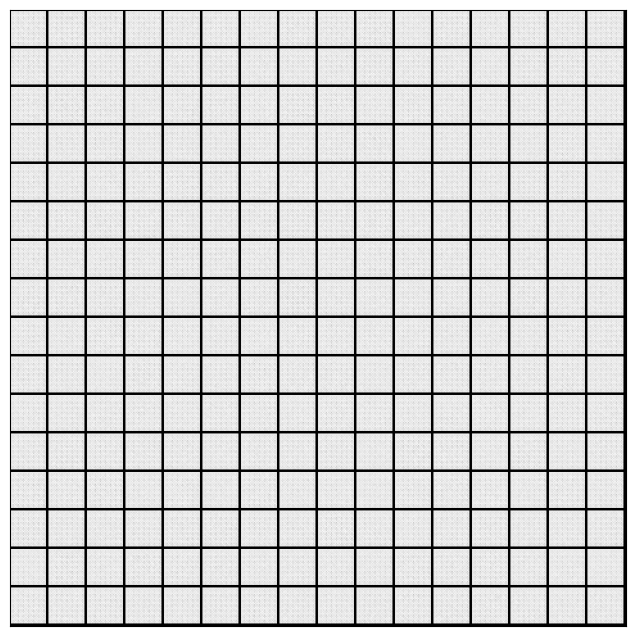

n_learn: 100
Error_fake: 0.6263619065284729 Acc_fake: 0.6796875
Error_real: 1.363332986831665 Acc_real: 0.140625


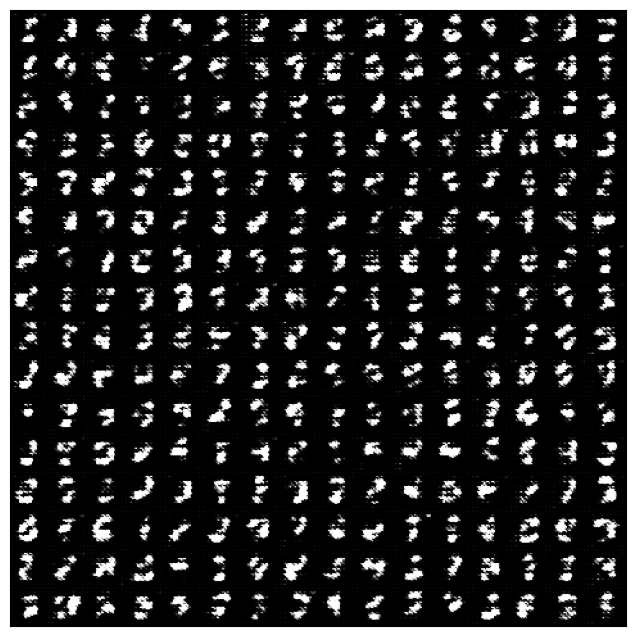

n_learn: 200
Error_fake: 0.6915746927261353 Acc_fake: 0.5625
Error_real: 0.8015255331993103 Acc_real: 0.1484375


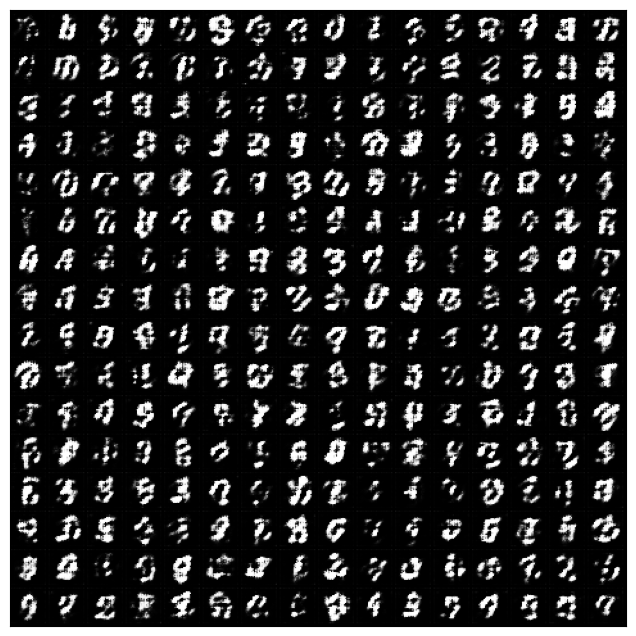

n_learn: 300
Error_fake: 0.7031859755516052 Acc_fake: 0.48828125
Error_real: 0.726069450378418 Acc_real: 0.3671875


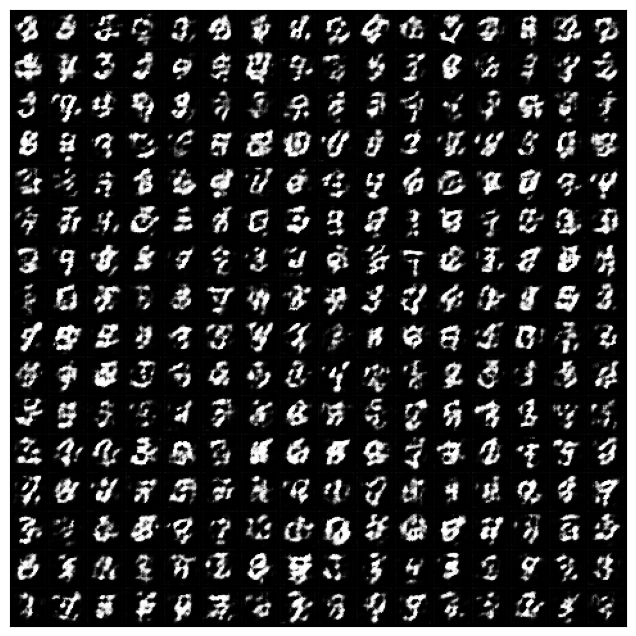

n_learn: 400
Error_fake: 0.6904234290122986 Acc_fake: 0.53515625
Error_real: 0.7347701787948608 Acc_real: 0.359375


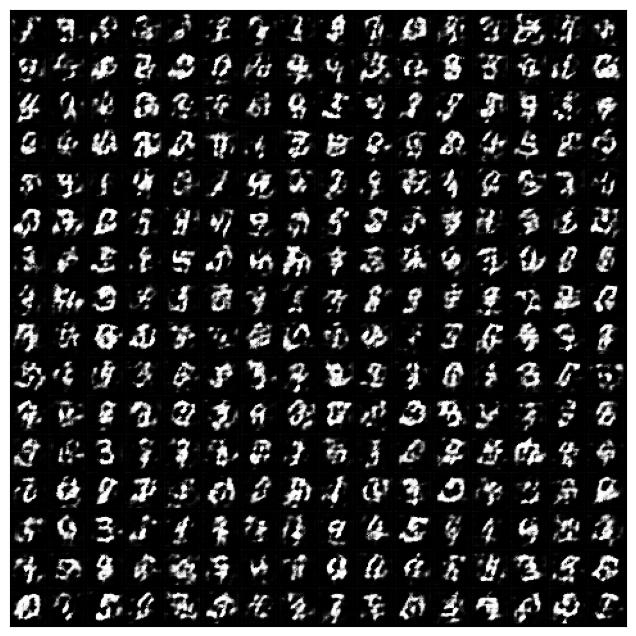

n_learn: 500
Error_fake: 0.6777299642562866 Acc_fake: 0.5546875
Error_real: 0.7366973161697388 Acc_real: 0.34375


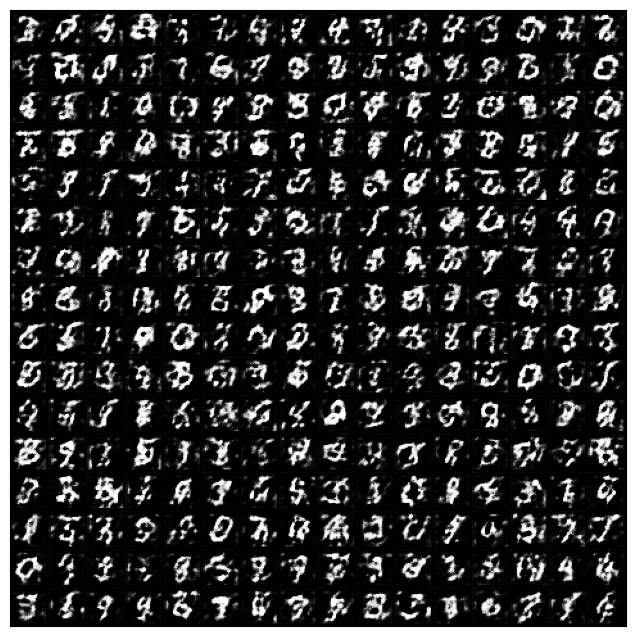

n_learn: 600
Error_fake: 0.6729943156242371 Acc_fake: 0.59375
Error_real: 0.7186826467514038 Acc_real: 0.3515625


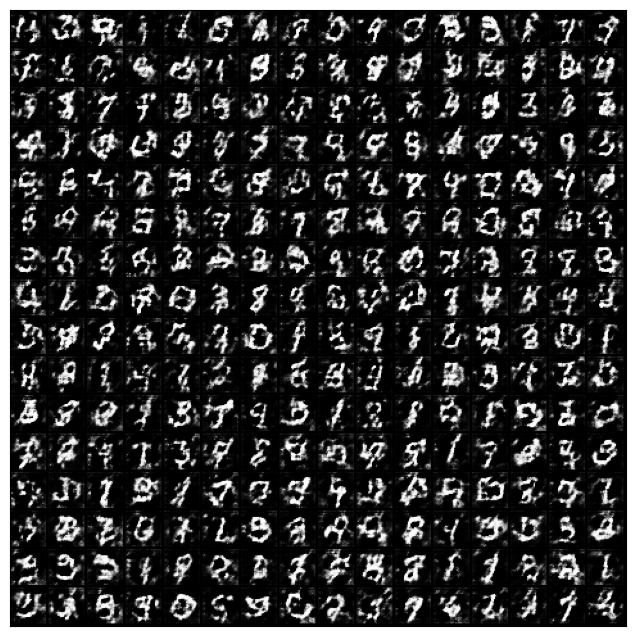

n_learn: 700
Error_fake: 0.671949177980423 Acc_fake: 0.5625
Error_real: 0.6902440190315247 Acc_real: 0.515625


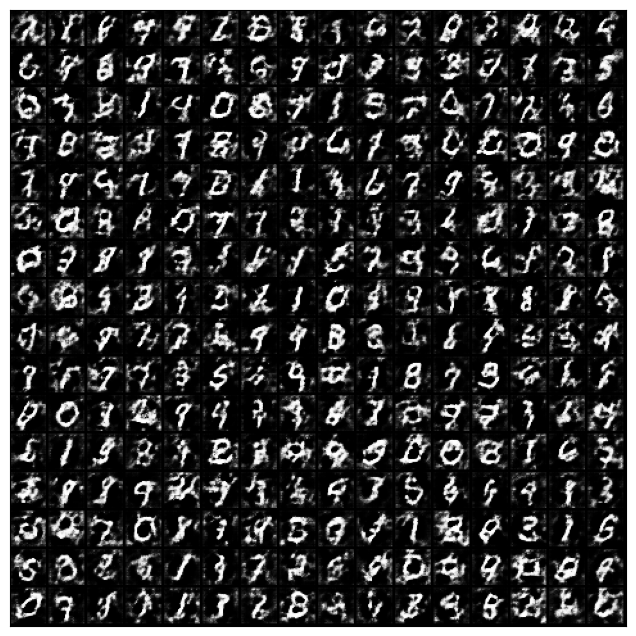

n_learn: 800
Error_fake: 0.6771007776260376 Acc_fake: 0.5703125
Error_real: 0.7348262071609497 Acc_real: 0.375


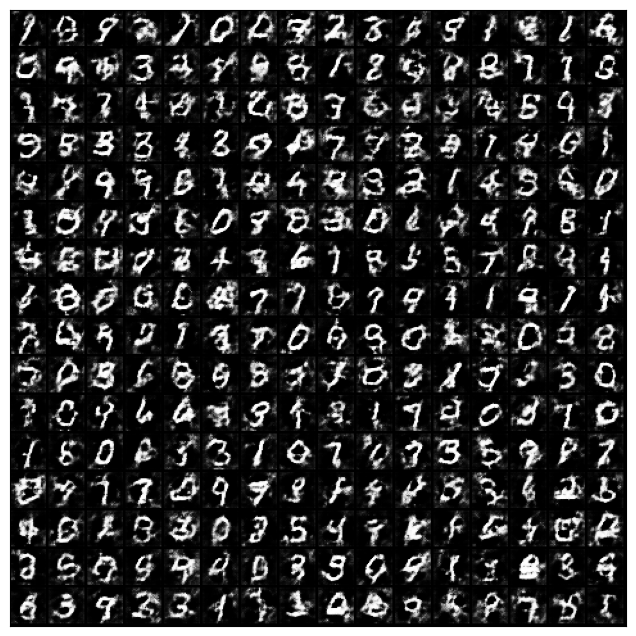

n_learn: 900
Error_fake: 0.6681433618068695 Acc_fake: 0.58203125
Error_real: 0.725737452507019 Acc_real: 0.359375


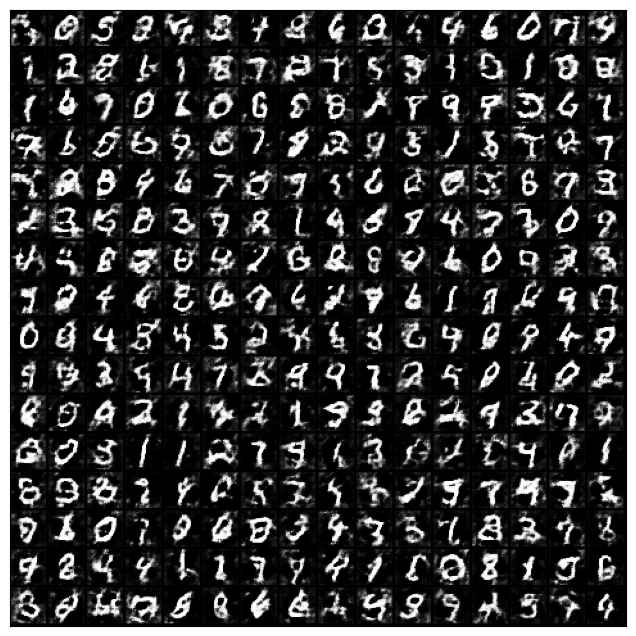

n_learn: 1000
Error_fake: 0.6917747855186462 Acc_fake: 0.52734375
Error_real: 0.7333743572235107 Acc_real: 0.34375


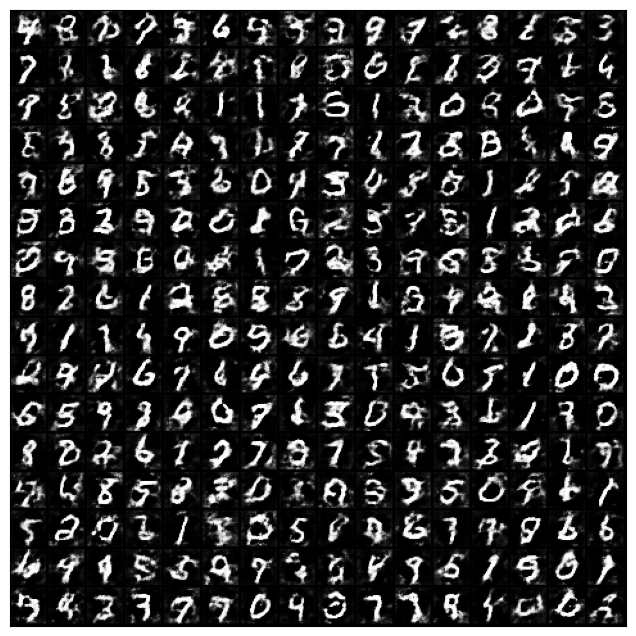

n_learn: 1100
Error_fake: 0.6780602633953094 Acc_fake: 0.54296875
Error_real: 0.7505885362625122 Acc_real: 0.3671875


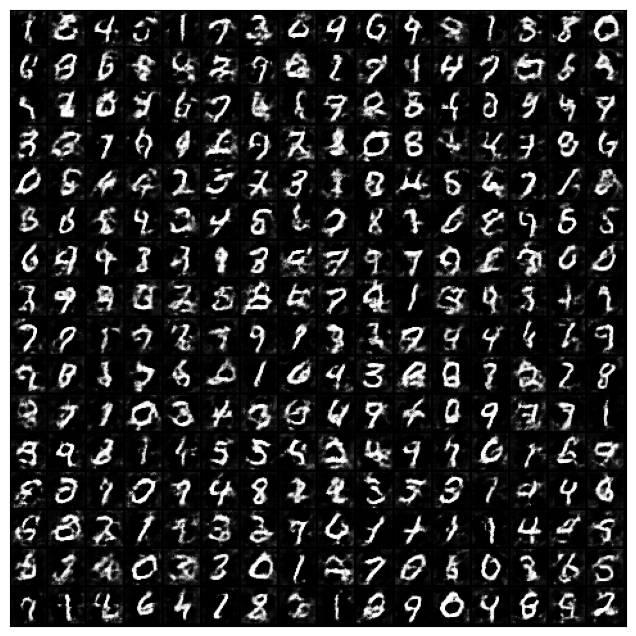

n_learn: 1200
Error_fake: 0.6725592613220215 Acc_fake: 0.5859375
Error_real: 0.7595033645629883 Acc_real: 0.3359375


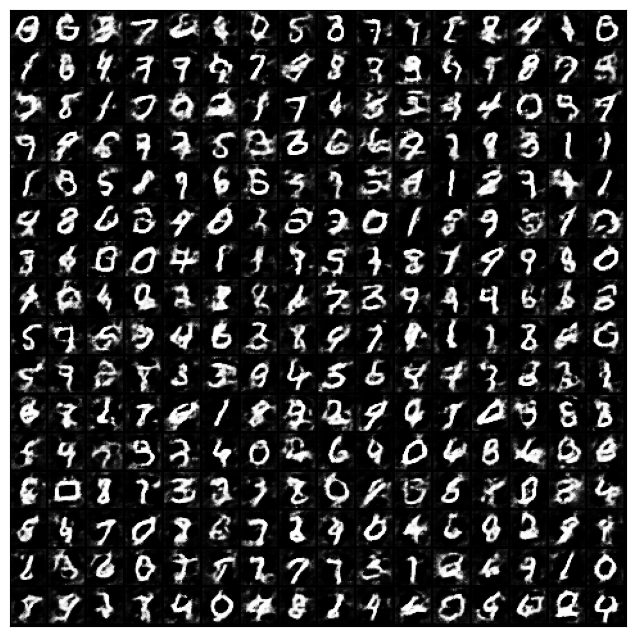

n_learn: 1300
Error_fake: 0.6704233288764954 Acc_fake: 0.625
Error_real: 0.8278281092643738 Acc_real: 0.2421875


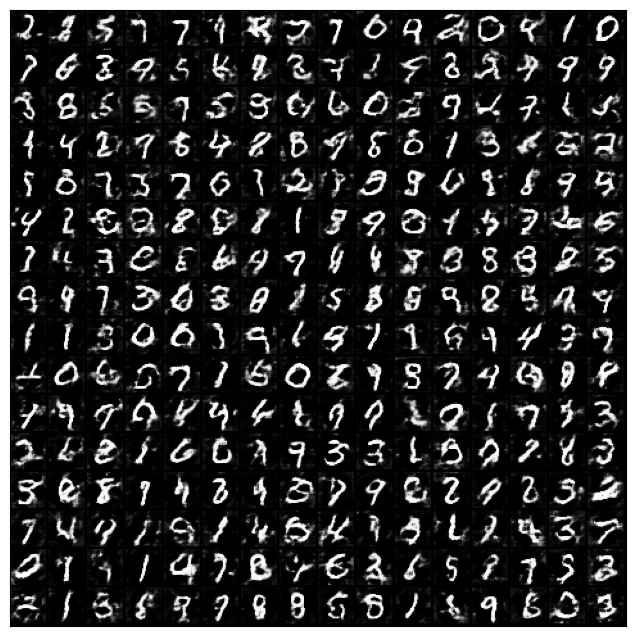

n_learn: 1400
Error_fake: 0.6648389101028442 Acc_fake: 0.5703125
Error_real: 0.809882402420044 Acc_real: 0.296875


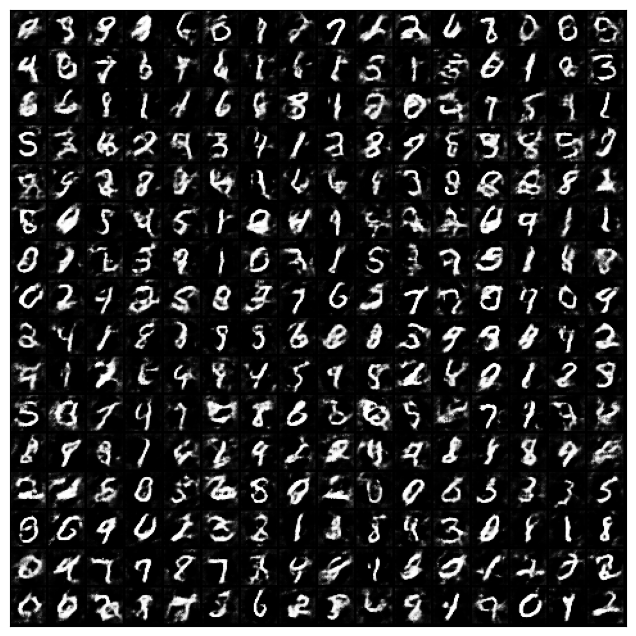

n_learn: 1500
Error_fake: 0.6863951981067657 Acc_fake: 0.5859375
Error_real: 0.7770463824272156 Acc_real: 0.3046875


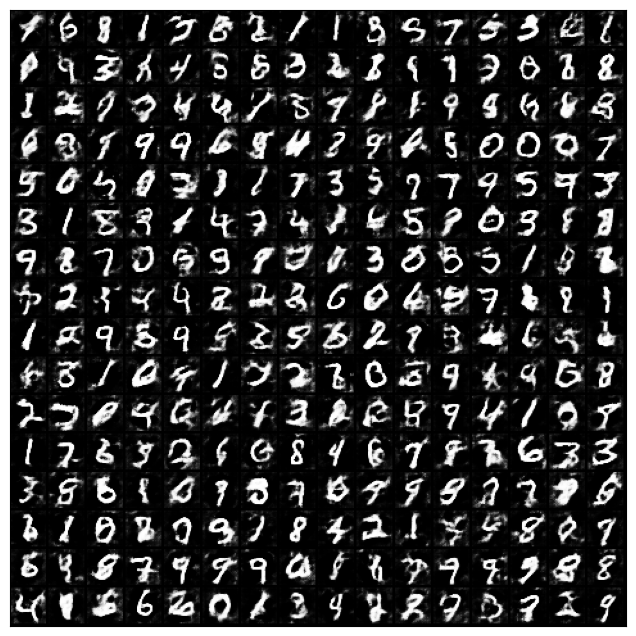

n_learn: 1600
Error_fake: 0.6594509184360504 Acc_fake: 0.640625
Error_real: 0.8563581705093384 Acc_real: 0.203125


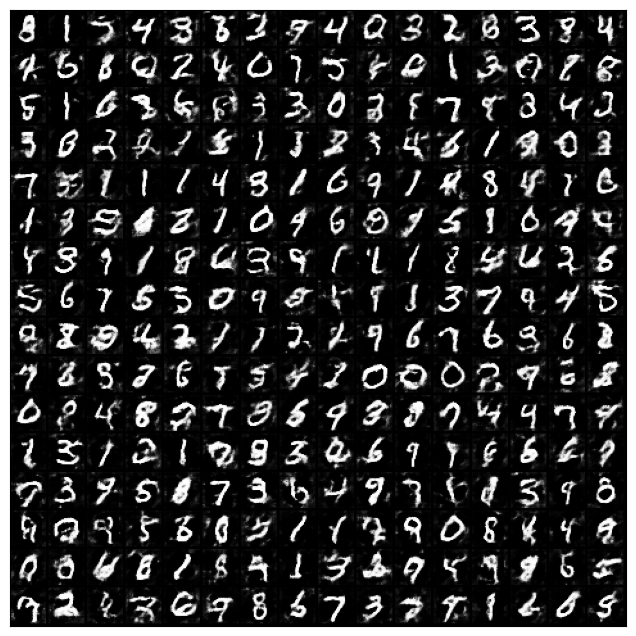

n_learn: 1700
Error_fake: 0.6509625315666199 Acc_fake: 0.6328125
Error_real: 0.81163090467453 Acc_real: 0.359375


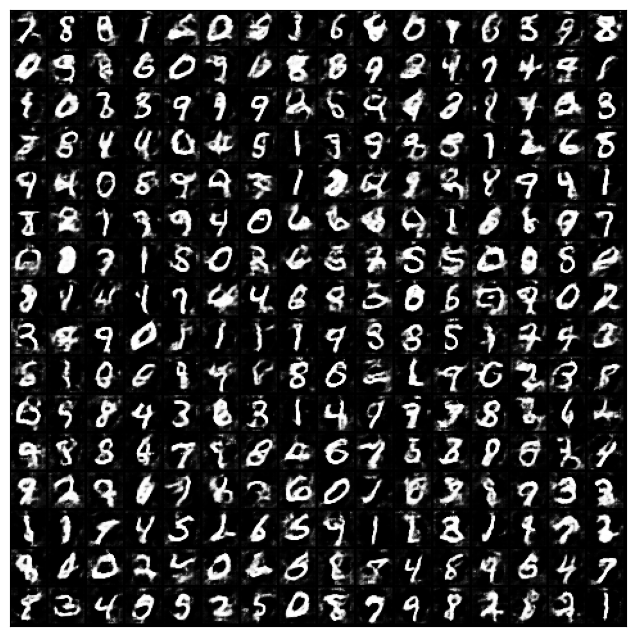

n_learn: 1800
Error_fake: 0.6768136322498322 Acc_fake: 0.56640625
Error_real: 0.8582577705383301 Acc_real: 0.2265625


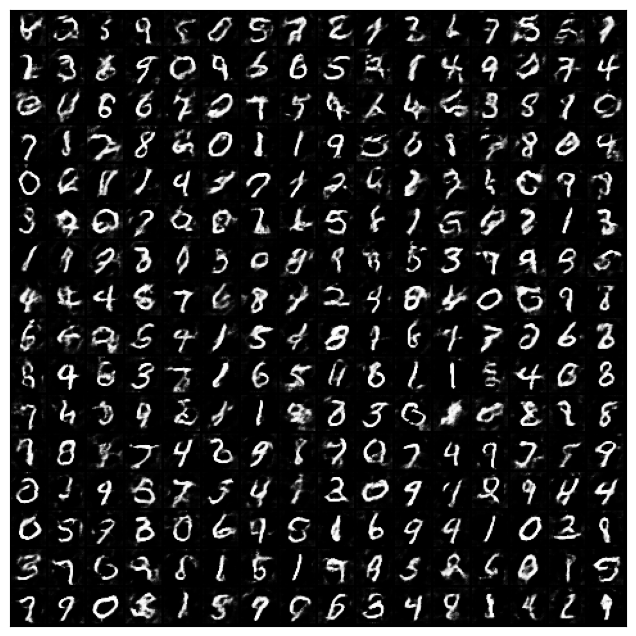

n_learn: 1900
Error_fake: 0.6530002951622009 Acc_fake: 0.5703125
Error_real: 0.8085752129554749 Acc_real: 0.2890625


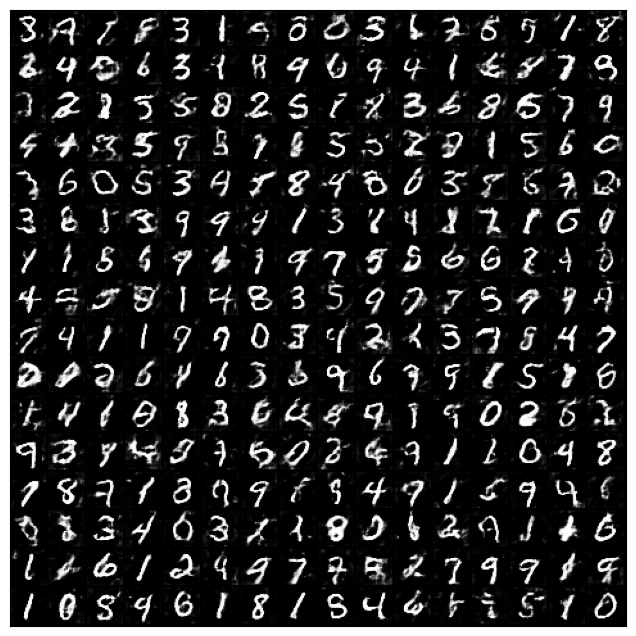

n_learn: 2000
Error_fake: 0.661764919757843 Acc_fake: 0.62109375
Error_real: 0.8366559743881226 Acc_real: 0.3046875


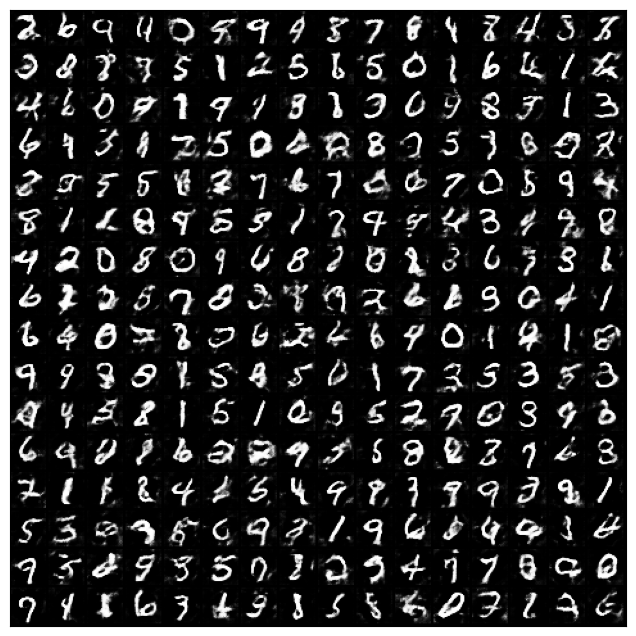

n_learn: 2100
Error_fake: 0.6548154950141907 Acc_fake: 0.59765625
Error_real: 0.8930250406265259 Acc_real: 0.234375


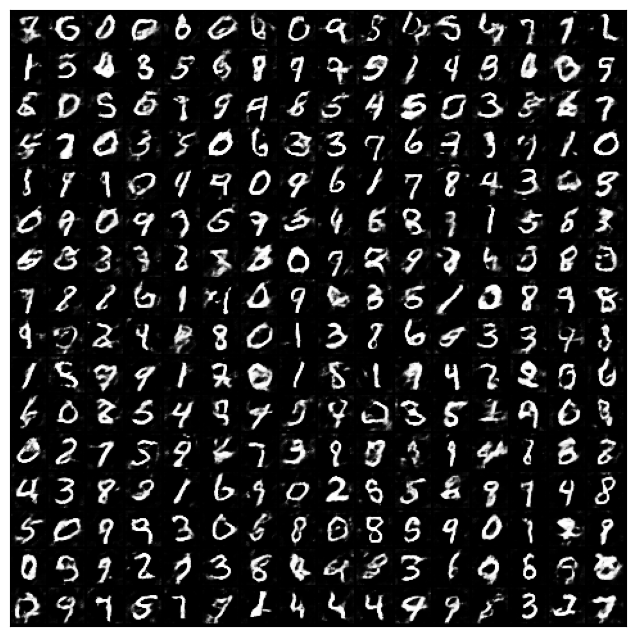

n_learn: 2200
Error_fake: 0.656909167766571 Acc_fake: 0.5859375
Error_real: 0.8870466947555542 Acc_real: 0.2421875


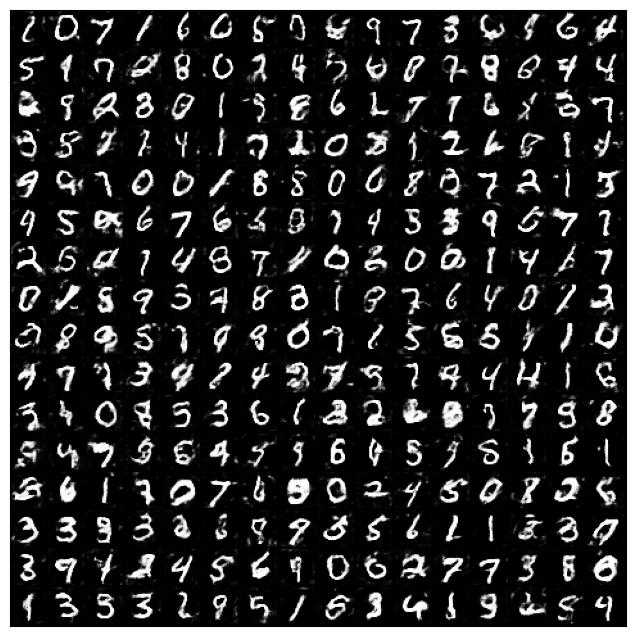

n_learn: 2300
Error_fake: 0.6726302802562714 Acc_fake: 0.60546875
Error_real: 0.8153905868530273 Acc_real: 0.3515625


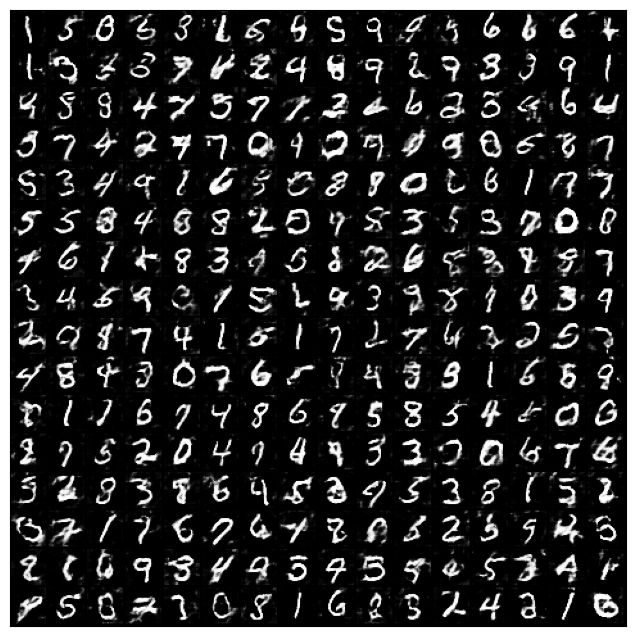

n_learn: 2400
Error_fake: 0.6962767243385315 Acc_fake: 0.52734375
Error_real: 0.900189995765686 Acc_real: 0.2265625


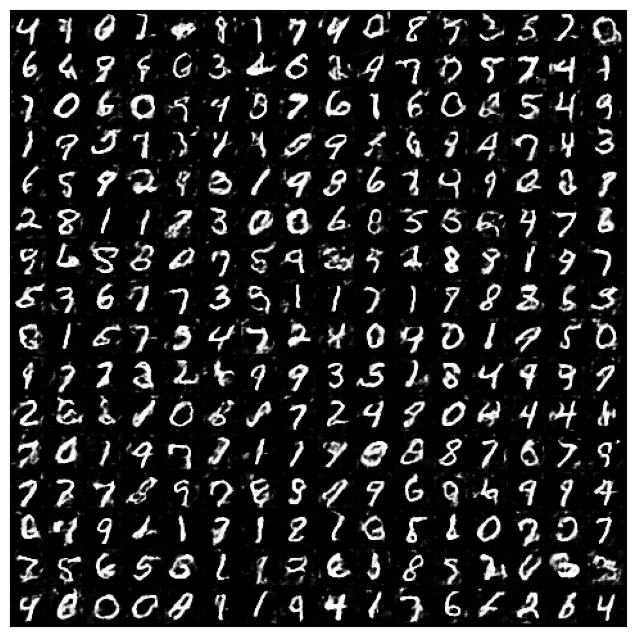

n_learn: 2500
Error_fake: 0.6664601564407349 Acc_fake: 0.59375
Error_real: 0.8691089153289795 Acc_real: 0.28125


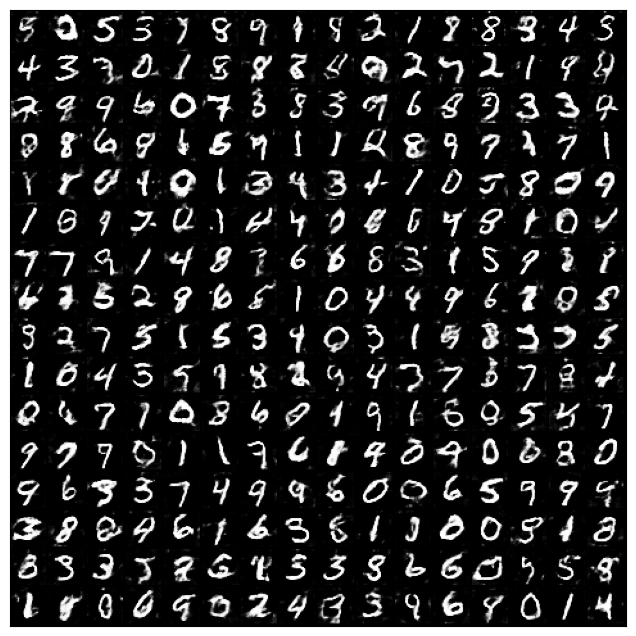

n_learn: 2600
Error_fake: 0.6770978271961212 Acc_fake: 0.6015625
Error_real: 0.848037838935852 Acc_real: 0.2890625


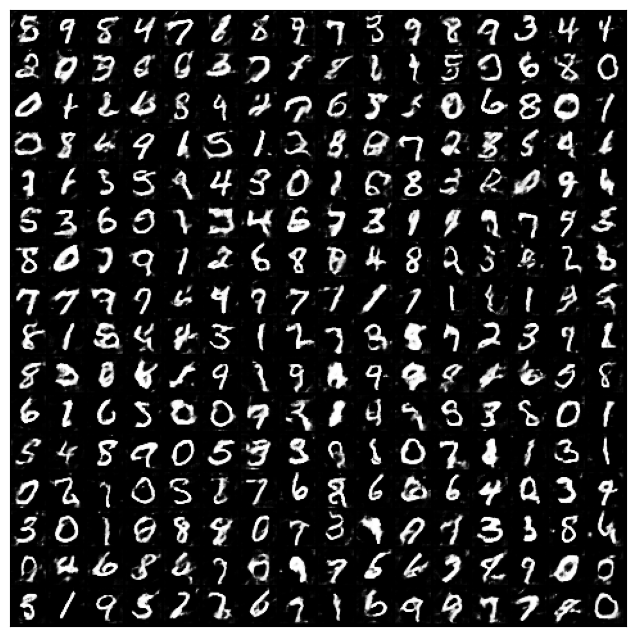

n_learn: 2700
Error_fake: 0.6479424834251404 Acc_fake: 0.6015625
Error_real: 0.8684254884719849 Acc_real: 0.3203125


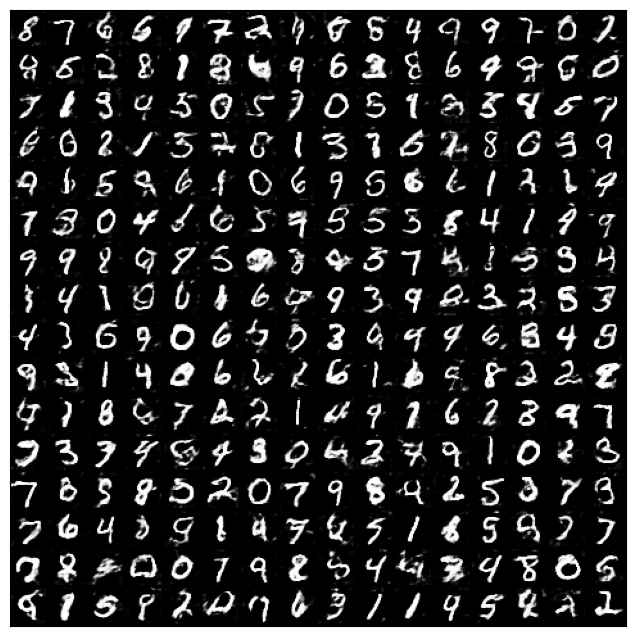

n_learn: 2800
Error_fake: 0.6579800844192505 Acc_fake: 0.609375
Error_real: 0.9437304735183716 Acc_real: 0.21875


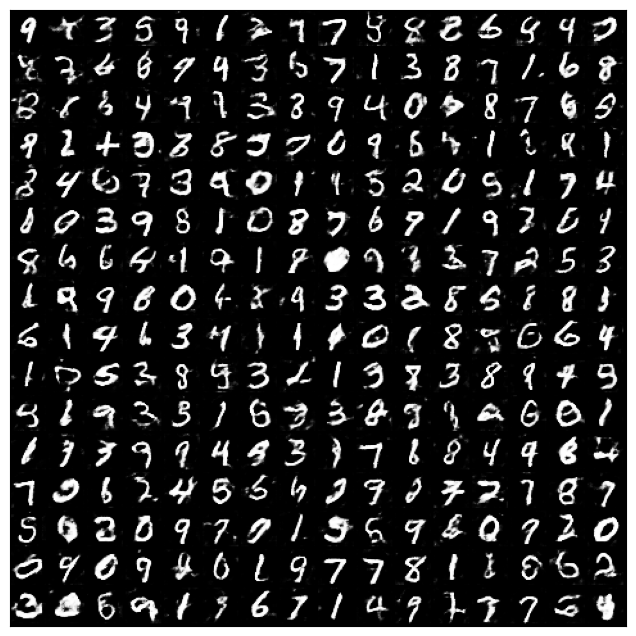

n_learn: 2900
Error_fake: 0.6292588710784912 Acc_fake: 0.64453125
Error_real: 0.90248703956604 Acc_real: 0.2734375


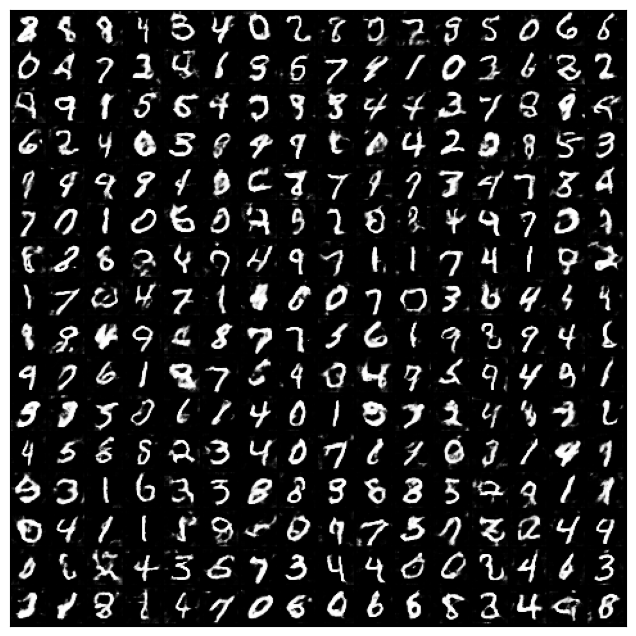

n_learn: 3000
Error_fake: 0.6607763767242432 Acc_fake: 0.59765625
Error_real: 0.9110993146896362 Acc_real: 0.2890625


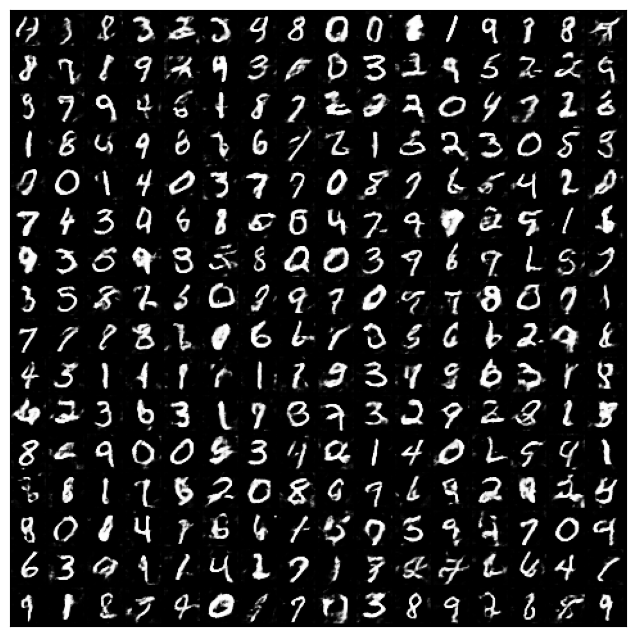

In [ ]:
n_learn = 3001
interval = 100
batch_size = 128
img_size = 28
batch_half = batch_size // 2

real = np.ones((batch_size, 1)).astype(int)
fake= np.zeros((batch_size, 1)).astype(int)
t = np.ones((batch_size, 1)).astype(int)

gan_error_record = np.zeros((n_learn, 2))
gan_acc_record = np.zeros((n_learn, 2))

for i in range(n_learn):

    #----------------------
    # Discriminatorの訓練
    #----------------------
    rand_ids = np.random.randint(len(x_train), size=batch_size)
    imgs_real = x_train[rand_ids]

    noise = np.randn(0, 1, (batch_size, n_noise))
    imgs_fake = gan.gen(noise)

    d_loss_real = discriminator.train_on_batch(imgs_real, real)
    d_loss_fake = discriminator.train_on_batch(imgs_fake, fake)
    d_loss, accuracy = np.add(d_loss_real,d_loss_fake)*0.5

    gan_error_record[i][0] = d_loss
    gan_acc_record[i][0] = accuracy

    #----------------------
    # Generatorの訓練
    #----------------------
    noise = np.random.normal(0, 1, (batch_size, n_noise))
    gen_imgs = gan.gen(noise)
    g_loss, accuracy = gan.train_on_batch(noise, t)

    gan_error_record[i][1] = g_loss
    gan_acc_record[i][1] = accuracy

    if i % interval == 0:
        print("n_learn:",i)
        print("Error_fake:",gan_error_record[i][0],
              "Acc_fake:",gan_acc_record[i][0])
        print("Error_real:",gan_error_record[i][1],
              "Acc_real:",gan_acc_record[i][1])
        generate_images(i, type='keras')

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optimizers

import numpy as np

class gen_conv(nn.Module):
    """Generator用のConvulution"""
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2, padding=1, final=False):
        super().__init__()
        if final:
            self.conv = nn.Conv2d(in_channels,
                                  out_channels,
                                  kernel_size=kernel_size,
                                  stride=stride,
                                  padding=padding,
                                  bias=False)
            self.act = nn.Tanh()
            self.bn = False
        else:
            self.conv = nn.ConvTranspose2d(in_channels,
                                       out_channels,
                                       kernel_size=kernel_size,
                                       stride=stride,
                                       padding=padding,
                                       bias=False)
            self.act = nn.ReLU()
            self.bn = nn.BatchNorm2d(out_channels, momentum=0.8)

    def forward(self, x):
        x = self.conv(x)
        if self.bn:
            x = self.bn(x)
        x = self.act(x)

        return x

class Generator(nn.Module):
    """Generator"""
    def __init__(self, z_dim=100, image_dim=1, img_size=28, hidden_dim=128):
        super().__init__()
        self.linear = nn.Linear(in_features=z_dim, out_features=128*7*7)
        self.act = nn.ReLU()

        self.gen1 = gen_conv(in_channels=hidden_dim, out_channels=128, kernel_size=4, stride=2, padding=1)
        self.gen2 = gen_conv(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1)
        self.gen3 = gen_conv(in_channels=64, out_channels=1, kernel_size=3, stride=1, padding=1, final=True)

    def forward(self, x):
        x = self.linear(x)
        x = self.act(x)
        x = x.view(-1,128,7,7)
        x = self.gen1(x)
        x = self.gen2(x)
        x = self.gen3(x)
        return x

class disc_conv(nn.Module):
    """Discriminator用のConvulution"""
    def __init__(self, in_channels, out_channels, kernel_size=5, stride=2, padding=1, bn=True, final=False):
        super().__init__()

        self.act = nn.LeakyReLU(negative_slope=0.2)
        self.drop = nn.Dropout(0.25)
        self.bn = nn.BatchNorm2d(out_channels)
        self.conv = nn.Conv2d(in_channels,
                              out_channels,
                              kernel_size=kernel_size,
                              stride=stride,
                              padding=padding,
                              bias=False)

    def forward(self, x):
        x = self.conv(x)
        #x = self.bn(x)
        x = self.drop(x)
        x = self.act(x)

        return x

class Discriminator(nn.Module):
    """Discriminator"""
    def __init__(self, img_size=28, hidden_dim=128):
        super().__init__()
        self.disc1 = disc_conv(in_channels=1, out_channels=32, kernel_size=4, stride=2, bn=False, padding=1)
        self.disc2 = disc_conv(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1)
        self.disc3 = disc_conv(in_channels=64, out_channels=128, kernel_size=3, stride=2, padding=1)
        self.disc4 = disc_conv(in_channels=128, out_channels=256, kernel_size=3, stride=1, padding=1)

        self.out = nn.Linear(in_features=256*4*4, out_features=1)
        self.act = torch.sigmoid

    def forward(self, x):
        x = self.disc1(x)
        x = self.disc2(x)
        x = self.disc3(x)
        x = self.disc4(x)
        x = nn.Flatten()(x)
        x = self.out(x)
        x = self.act(x)
        return x.squeeze()

In [ ]:
from torchsummary import summary

model = Generator()
summary(model, (1,100))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1              [-1, 1, 6272]         633,472
              ReLU-2              [-1, 1, 6272]               0
   ConvTranspose2d-3          [-1, 128, 14, 14]         262,272
       BatchNorm2d-4          [-1, 128, 14, 14]             256
              ReLU-5          [-1, 128, 14, 14]               0
          gen_conv-6          [-1, 128, 14, 14]               0
   ConvTranspose2d-7           [-1, 64, 28, 28]         131,136
       BatchNorm2d-8           [-1, 64, 28, 28]             128
              ReLU-9           [-1, 64, 28, 28]               0
         gen_conv-10           [-1, 64, 28, 28]               0
           Conv2d-11            [-1, 1, 28, 28]             577
             Tanh-12            [-1, 1, 28, 28]               0
         gen_conv-13            [-1, 1, 28, 28]               0
Total params: 1,027,841
Trainable param

In [ ]:
model = Discriminator()
summary(model, (1,28,28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 14, 14]             544
           Dropout-2           [-1, 32, 14, 14]               0
         LeakyReLU-3           [-1, 32, 14, 14]               0
         disc_conv-4           [-1, 32, 14, 14]               0
            Conv2d-5             [-1, 64, 7, 7]          32,832
           Dropout-6             [-1, 64, 7, 7]               0
         LeakyReLU-7             [-1, 64, 7, 7]               0
         disc_conv-8             [-1, 64, 7, 7]               0
            Conv2d-9            [-1, 128, 4, 4]          73,856
          Dropout-10            [-1, 128, 4, 4]               0
        LeakyReLU-11            [-1, 128, 4, 4]               0
        disc_conv-12            [-1, 128, 4, 4]               0
           Conv2d-13            [-1, 256, 4, 4]         295,168
          Dropout-14            [-1, 25

<ipython-input-6-9fb713e68d74>:9: UserWarning: nn.init.normal is now deprecated in favor of nn.init.normal_.
  torch.nn.init.normal(m.weight, 0.0,1.0)


n_learn: 0
0.5029972195625305 0.4984106421470642


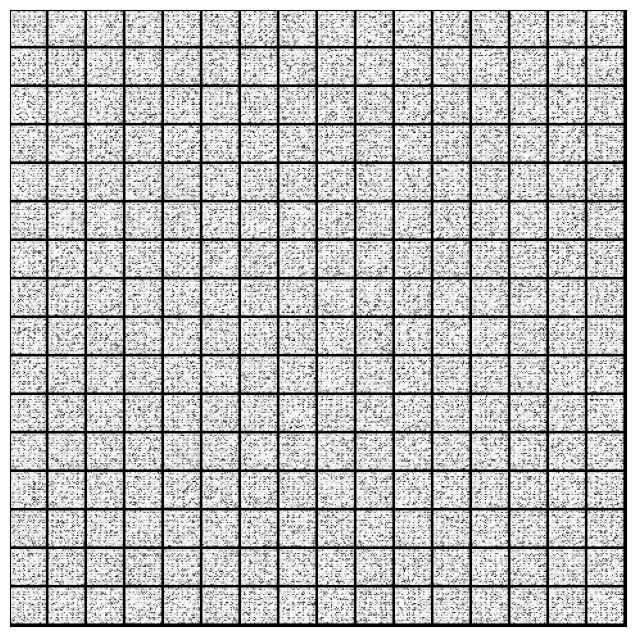

n_learn: 100
0.8676810264587402 0.6410913467407227


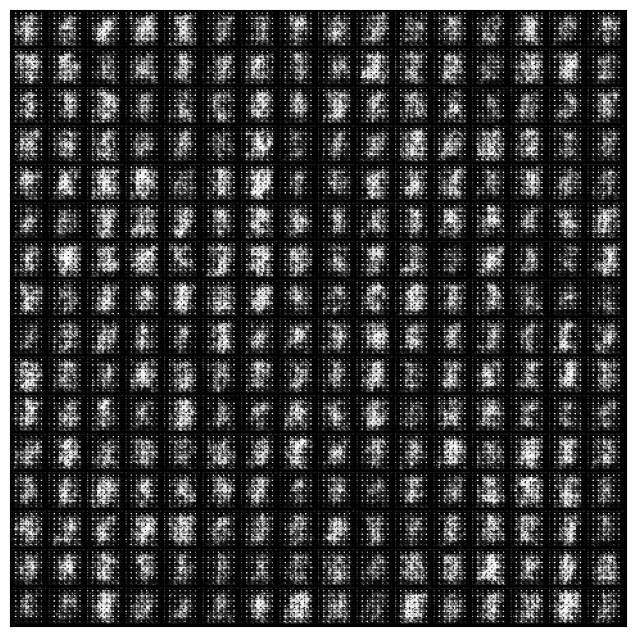

n_learn: 200
0.4587760269641876 0.4393848180770874


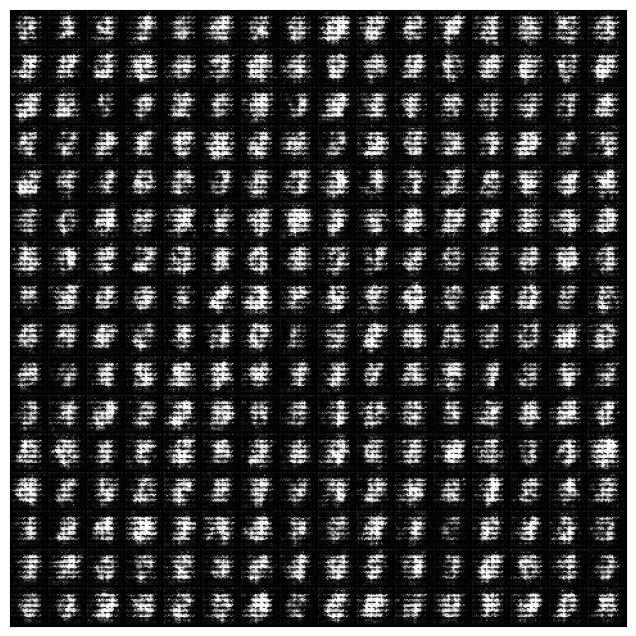

n_learn: 300
0.5156495571136475 0.49826931953430176


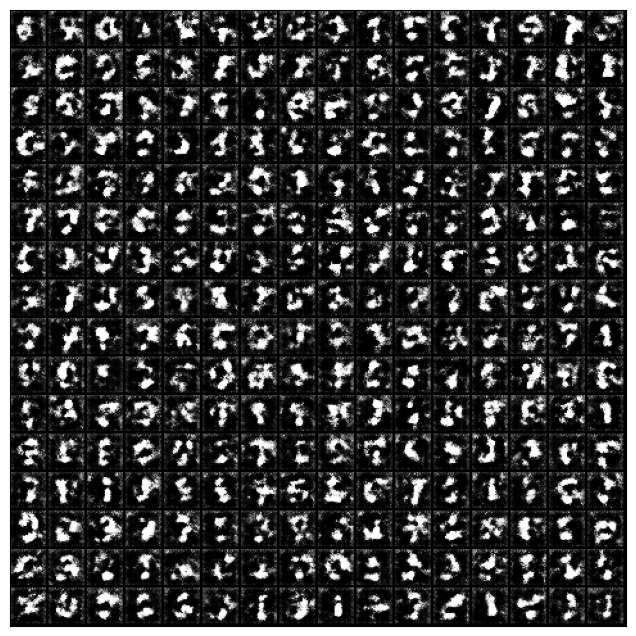

n_learn: 400
0.4834263026714325 0.4854589104652405


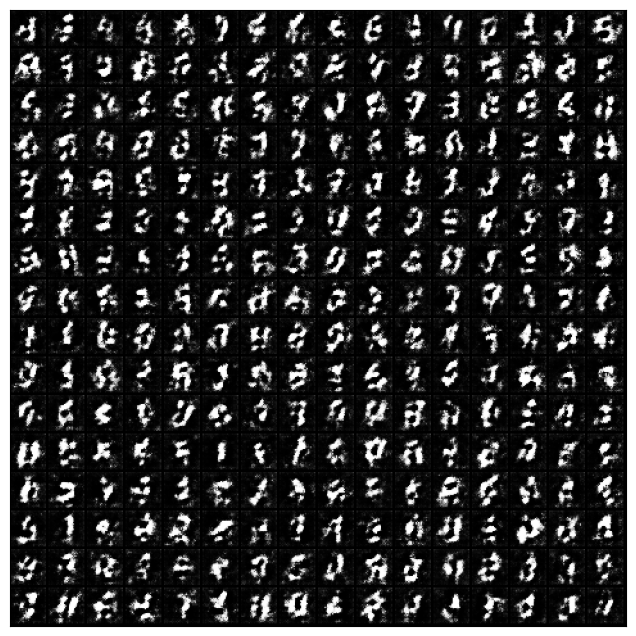

n_learn: 500
0.4827963709831238 0.507321834564209


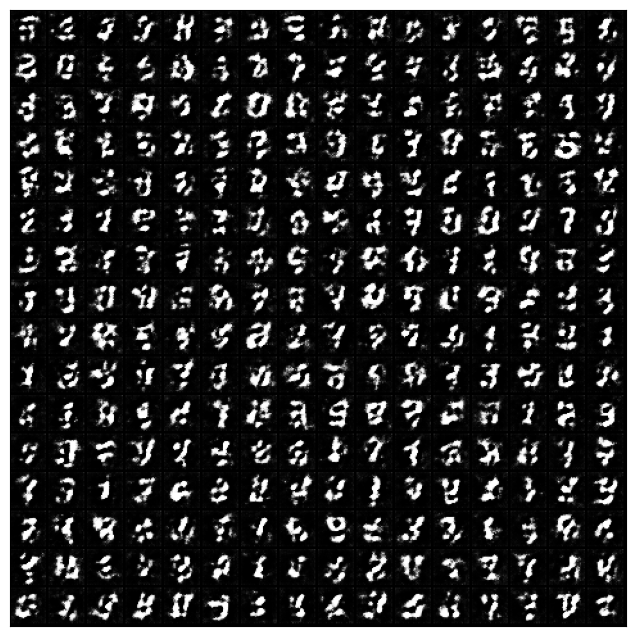

n_learn: 600
0.5091250538825989 0.441972017288208


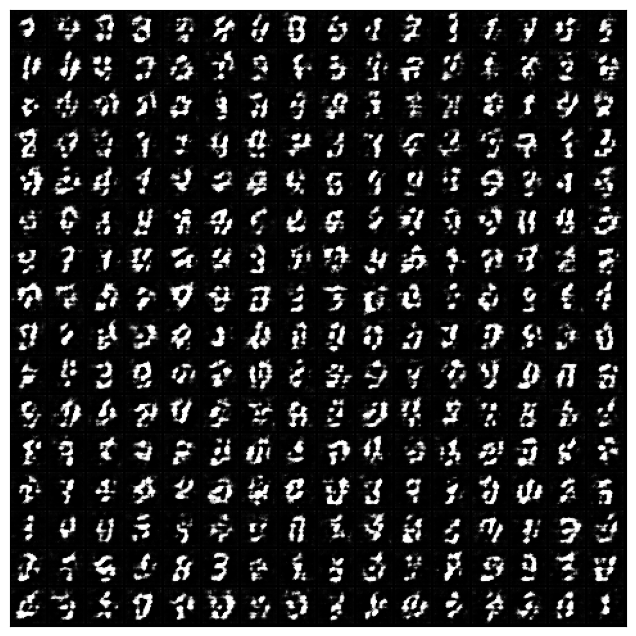

n_learn: 700
0.5078349709510803 0.4256362020969391


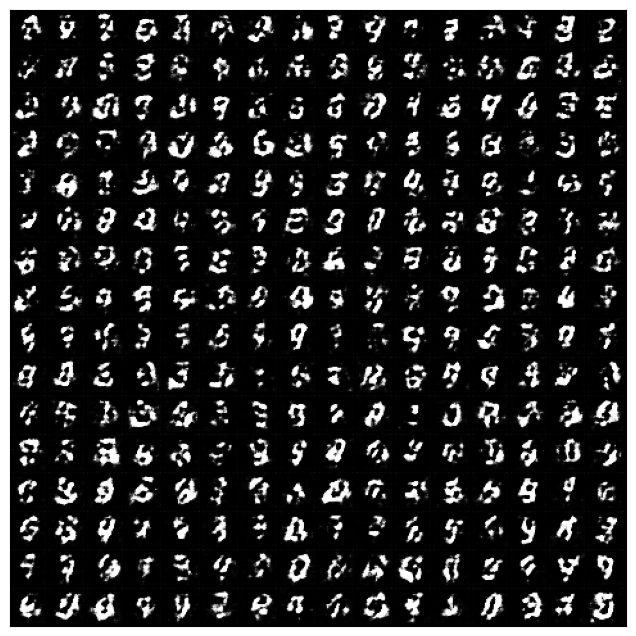

n_learn: 800
0.4621560871601105 0.4492202401161194


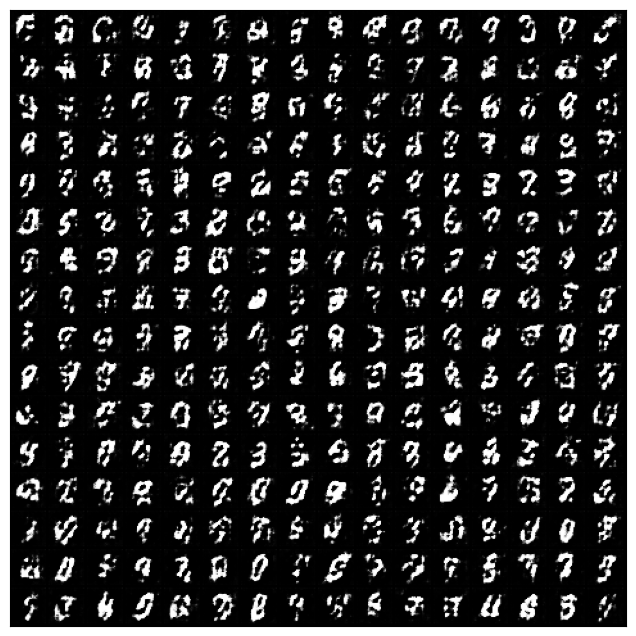

n_learn: 900
0.42220667004585266 0.4680367112159729


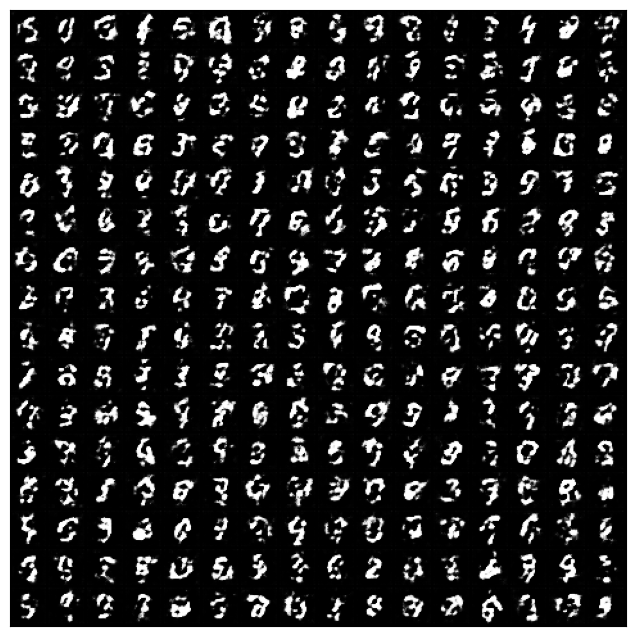

n_learn: 1000
0.3692498803138733 0.5055787563323975


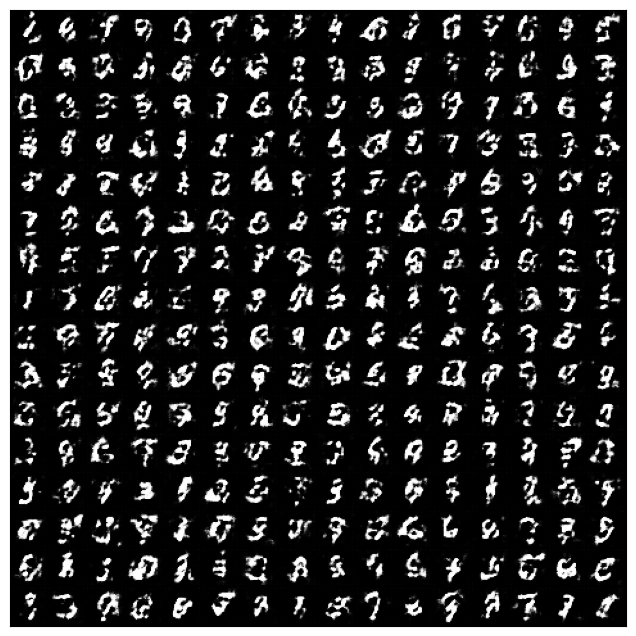

n_learn: 1100
0.3321387767791748 0.6061927676200867


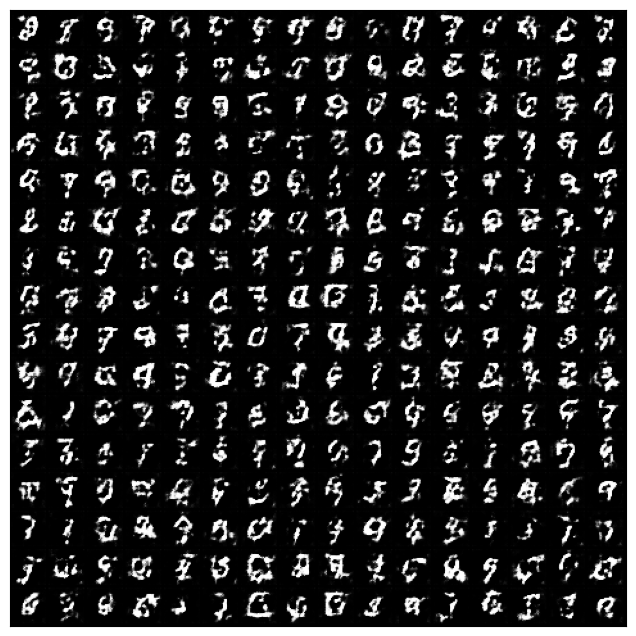

n_learn: 1200
0.30674153566360474 0.5209308862686157


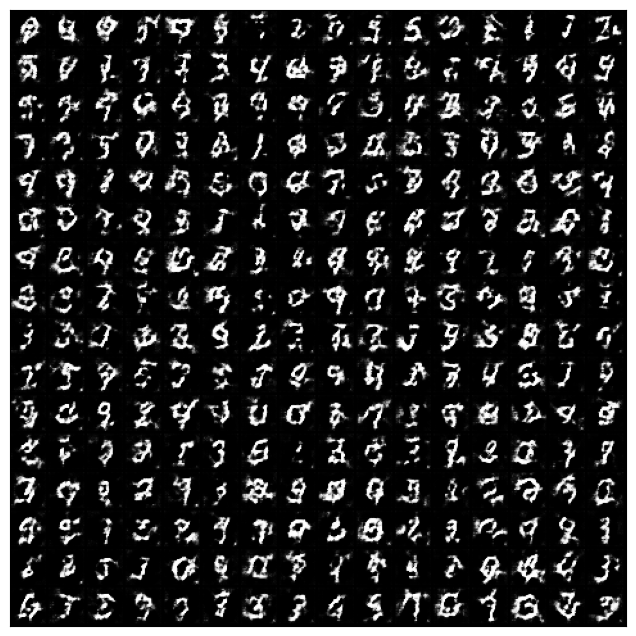

n_learn: 1300
0.43224936723709106 0.4502962529659271


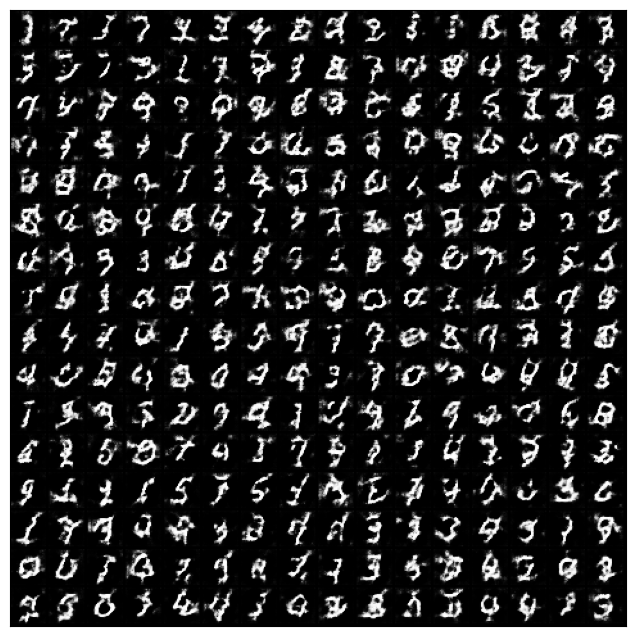

n_learn: 1400
0.520861029624939 0.38747647404670715


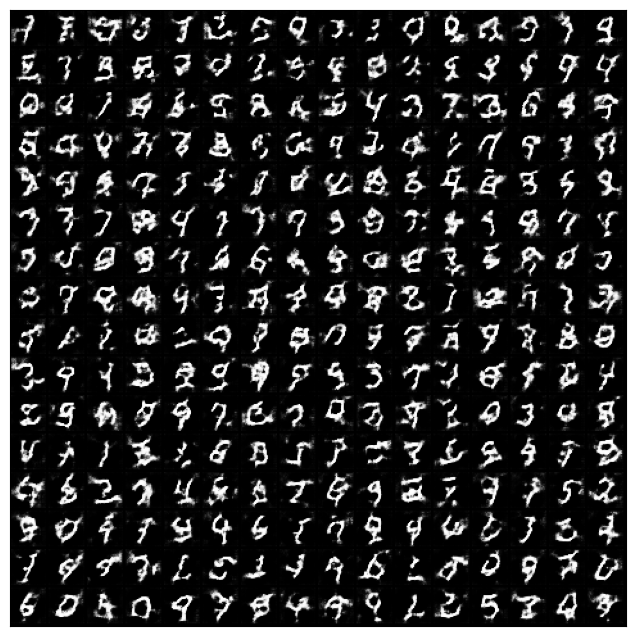

n_learn: 1500
0.45053553581237793 0.4135488271713257


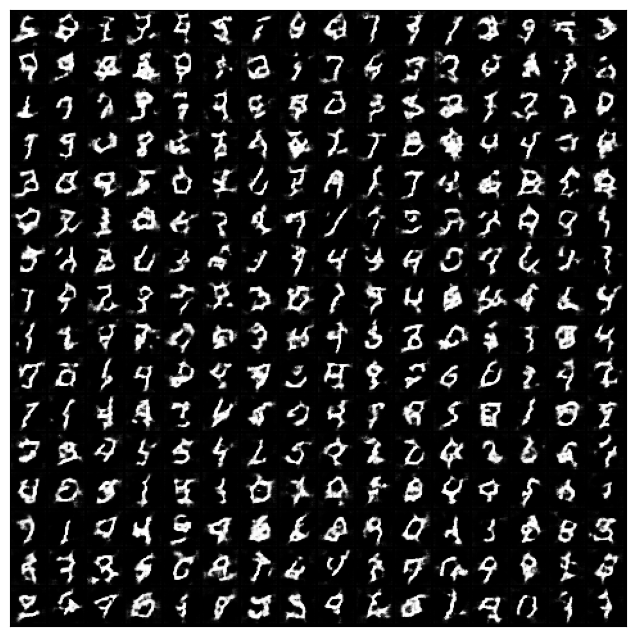

n_learn: 1600
0.4791523218154907 0.422195166349411


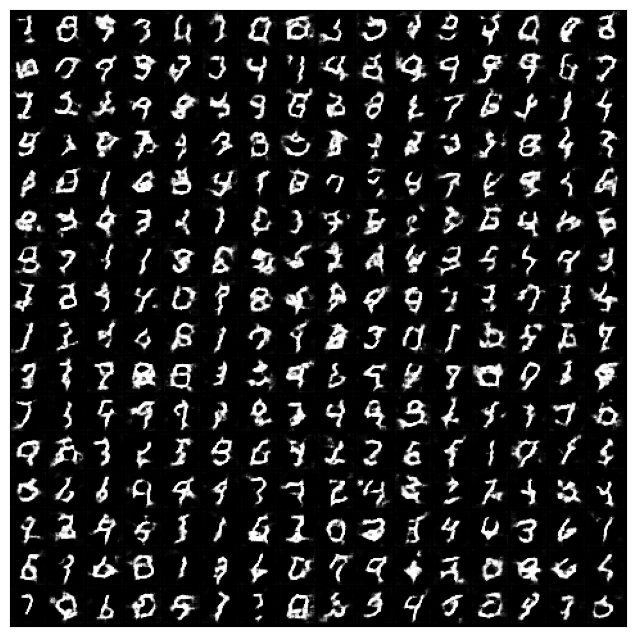

n_learn: 1700
0.4695601761341095 0.4630432426929474


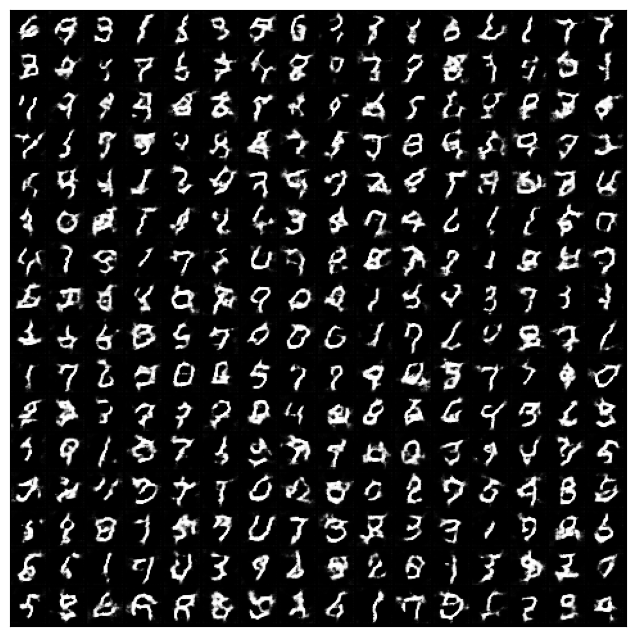

n_learn: 1800
0.4679896831512451 0.4415695369243622


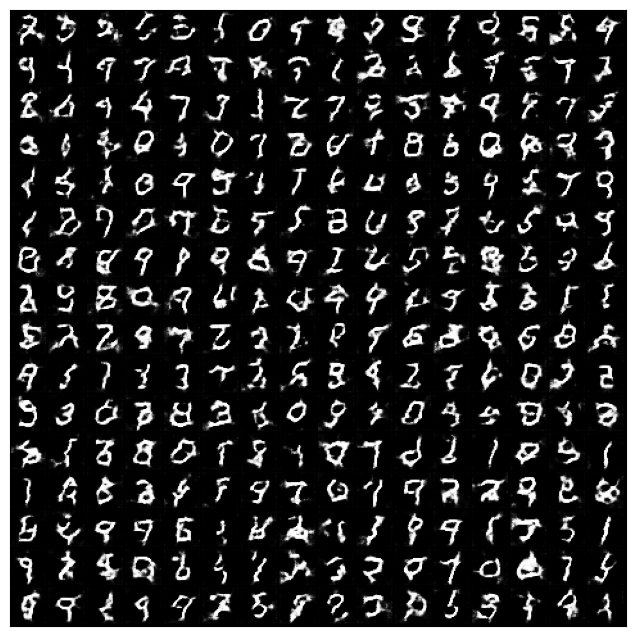

n_learn: 1900
0.45244356989860535 0.45786598324775696


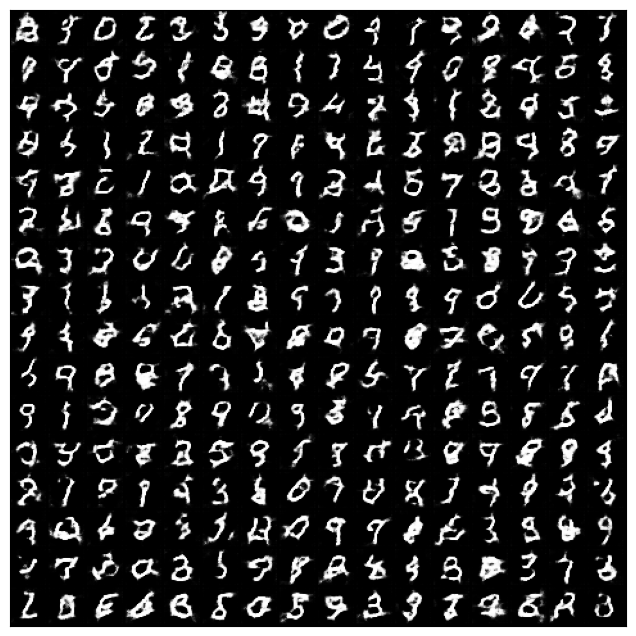

n_learn: 2000
0.50680011510849 0.41661643981933594


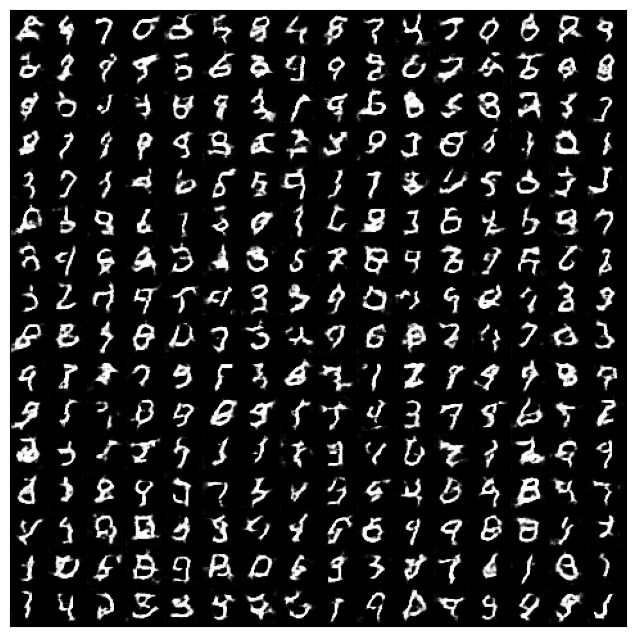

n_learn: 2100
0.4437004029750824 0.47153159976005554


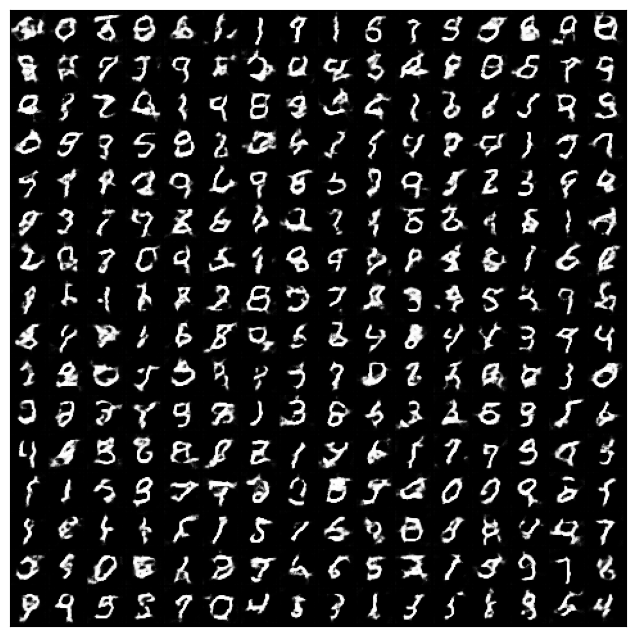

n_learn: 2200
0.41920197010040283 0.4677671790122986


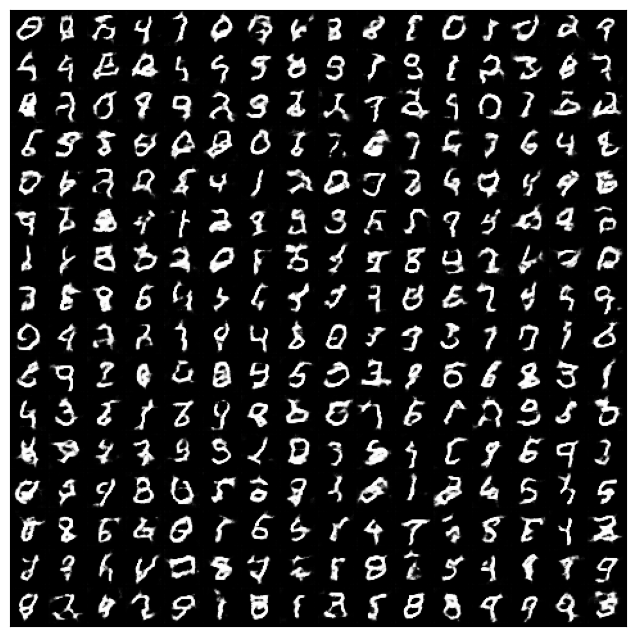

n_learn: 2300
0.4040887951850891 0.47229647636413574


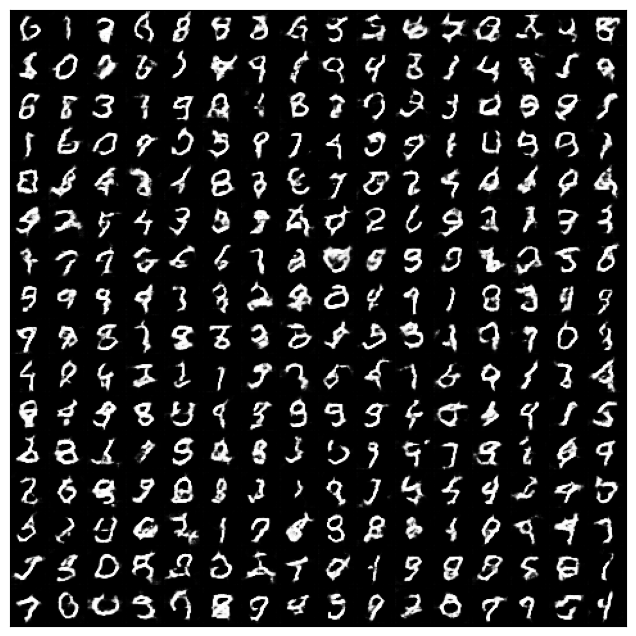

n_learn: 2400
0.49497637152671814 0.44464579224586487


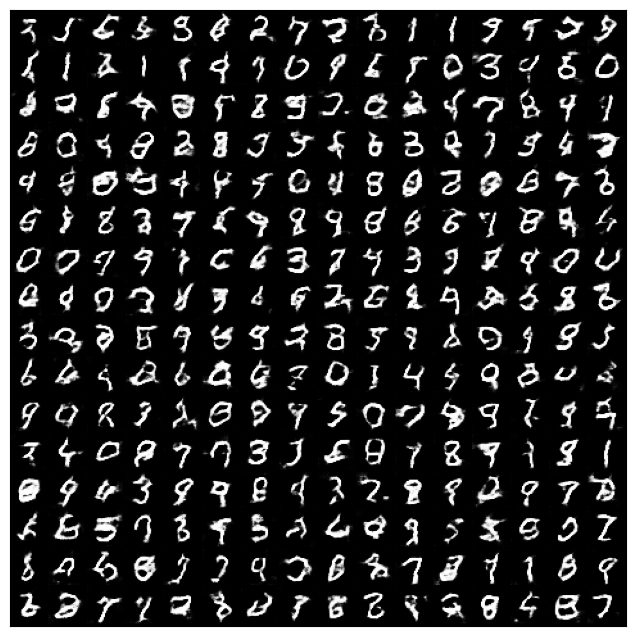

n_learn: 2500
0.4783173203468323 0.4202312231063843


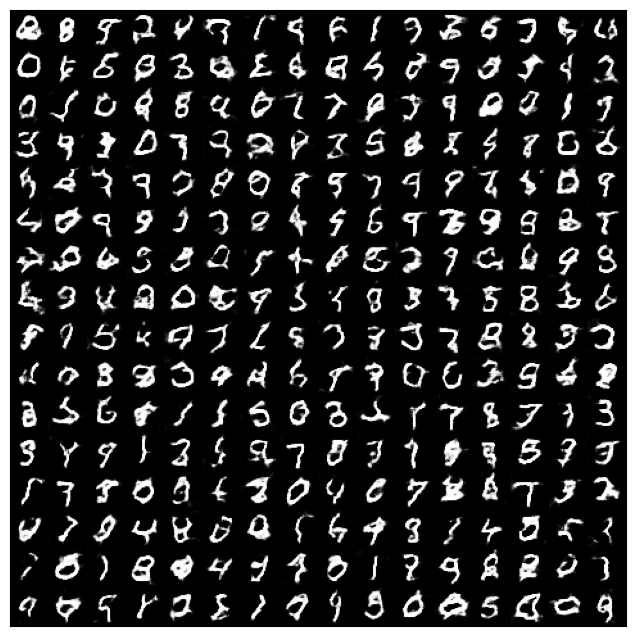

n_learn: 2600
0.43904903531074524 0.4671321511268616


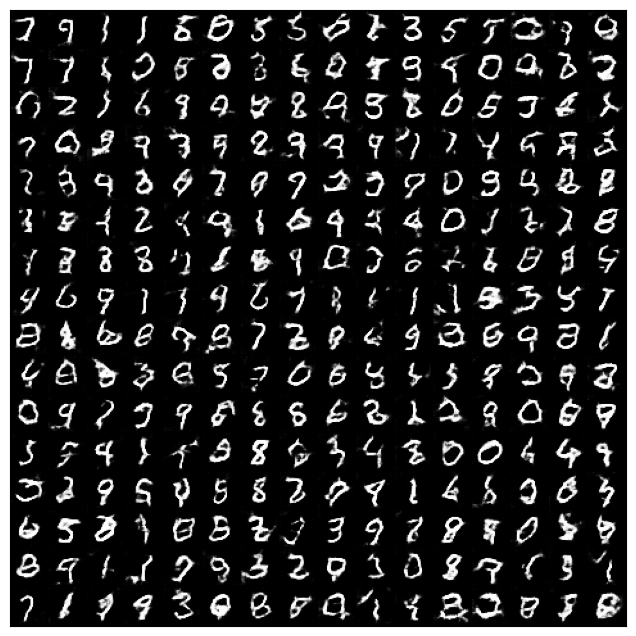

n_learn: 2700
0.43363404273986816 0.46101200580596924


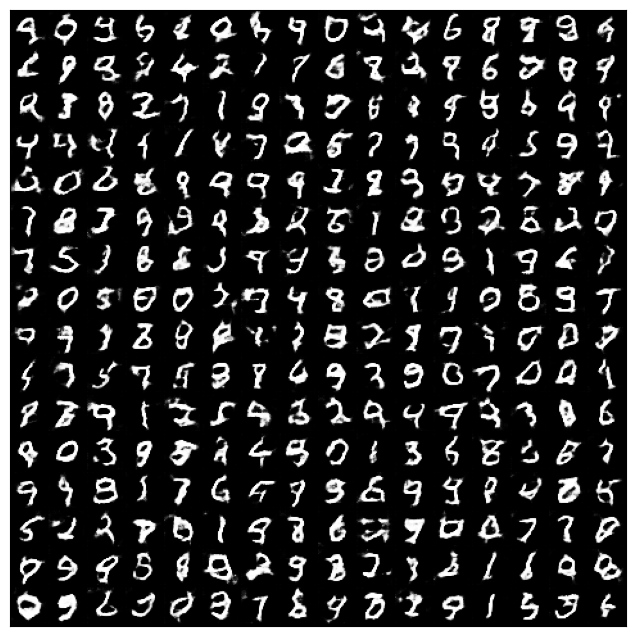

n_learn: 2800
0.45072096586227417 0.44723889231681824


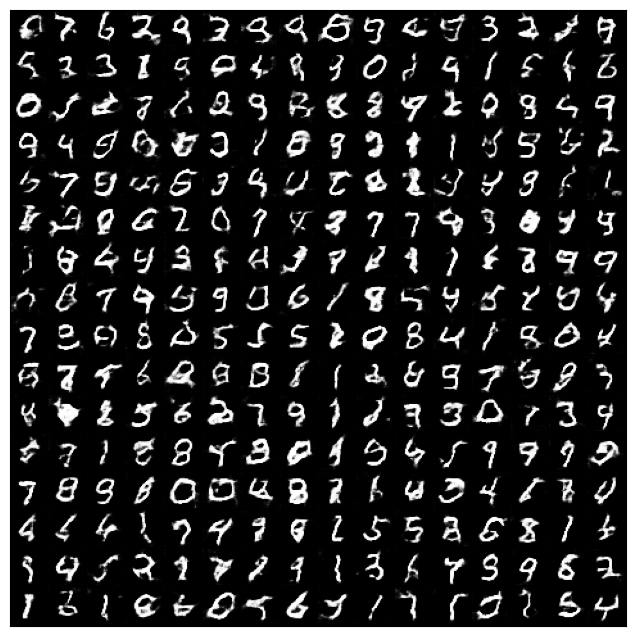

n_learn: 2900
0.4139276146888733 0.43778663873672485


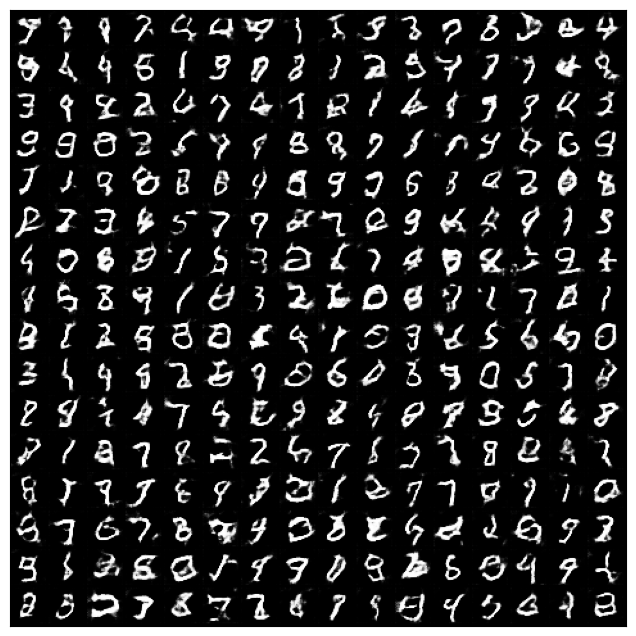

n_learn: 3000
0.4130772054195404 0.4807923436164856


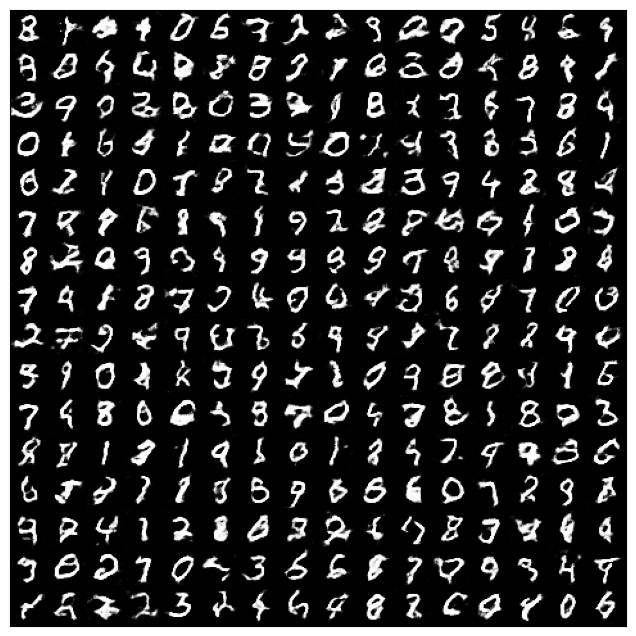

In [ ]:
discriminator = Discriminator()
generator = Generator()

# ウェイトの初期化
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.xavier_uniform_(m.weight, 1.0)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal(m.weight, 0.0,1.0)
        torch.nn.init.constant_(m.bias, 0)

generator = generator.apply(weights_init)
discriminator = discriminator.apply(weights_init)

criterion = nn.BCELoss()

optimizerD = torch.optim.Adam(discriminator.parameters(), lr=2e-4, betas=(0.2, 0.999), eps=1e-7)
optimizerG = torch.optim.Adam(generator.parameters(), lr=2e-4, betas=(0.2, 0.999), eps=1e-7)

n_learn = 3001
interval = 100
batch_size = 128
n_noise=100
img_size=28

real = torch.full((batch_size,),1, dtype=torch.float32)
real2 = torch.full((batch_size*2,),1, dtype=torch.float32)
fake= torch.full((batch_size,),0, dtype=torch.float32)

gan_error_record = np.zeros((n_learn, 2))
gan_acc_record = np.zeros((n_learn, 2))

for i in range(n_learn):
    #----------------------
    # Discriminatorの訓練
    #----------------------
    # 正解画像で損失の計算(正解ラベル:1)
    rand_ids = np.random.randint(len(x_train), size=batch_size)
    imgs_real = torch.tensor(x_train[rand_ids], dtype=torch.float32)
    imgs_real = imgs_real.transpose(3,1).transpose(3,2)

    discriminator.zero_grad()
    output = discriminator(imgs_real)
    d_loss_real = criterion(output, real)

    d_x = output.mean().item()

    # 生成画像で損失の計算(正解ラベル:0)
    noise = torch.randn(batch_size, n_noise)
    #noise = torch.normal(0,1,(batch_size, n_noise))
    fake_image = generator(noise)

    output = discriminator(fake_image)
    d_loss_fake = criterion(output, fake)

    d_g_z1 = output.mean().item()

    # 2つの損失を足して訓練
    d_loss = (d_loss_real+d_loss_fake)*0.5
    d_loss.backward()
    optimizerD.step()

    #----------------------
    # Generatorの訓練
    #----------------------
    # 生成画像で損失の計算(正解ラベル:1)
    noise = torch.randn(batch_size, n_noise)
    #noise = torch.normal(0,1,(batch_size, n_noise))
    fake_image = generator(noise)

    generator.zero_grad()
    output = discriminator(fake_image)
    g_loss = criterion(output, real)

    # 訓練
    g_loss.backward()
    d_g_z2 = output.mean().item()
    optimizerG.step()

    if i % interval == 0:
        print("n_learn:",i)
        print(d_g_z1,d_g_z2)
        generate_images(i, type='torch')

In [ ]:
imgs_real.shape

torch.Size([128, 1, 28, 28])